## Model with senescence



This notebook contains the plots and some analysis for the model with senescence. Note that the fitting to data is handled separately to this, within the mainFibSnC.py file. 

Plots include the nullclines of the system, intersection of nullclines, fixed points and example trajectories of injuries (with optional pulses of macrophages and senescence).

In [3]:
# Import Python packages, classes and functions

import senescence_model as sm
import fibrosis_model as fm
import fibrosis_senescence_model as fsm
import state_parameter_maker as spm

import numpy as np
import time
import scipy.integrate 
import matplotlib.pyplot as plt
import plotting as ping
import matplotlib as mpl
import matplotlib.patches as mpatches
import plotly.graph_objects as go
import plotly.express as px
# Higher dpi for plots
mpl.rcParams['figure.dpi'] = 200
mpl.rcParams['savefig.dpi'] = 200
mpl.rcParams['axes.facecolor'] = 'snow'  # Replace 'lightgray' with your desired color

In [4]:
min2day = 24*60 # To allow the conversion of constants from the Adler et al. paper which are in minutes into days

initial_state_fsm = spm.state_fsm(10, 10, 10, 10, 10)  # Initial cell populations, M, F, P, C, S
    
initial_params_fsm = spm.params_fsm(lam1=0.9, lam2=0.8, mu1=0.3, mu2=0.3, K=1e6, k1=1e9,k2=1e9,
                                beta1=470 * min2day,beta2=70 * min2day,beta3=240 * min2day,
                                alpha1=940 *min2day,alpha2=510 *min2day, gamma=2,
                                  n=0.003,h=50, r=24, q=1e4)  # Parameters for the model
sys_s1 = fsm.fibrosis_senescence_model(initial_params_fsm,initial_state_fsm) # Initialise instance of the model

In [5]:
## Extra helpers for plotting, avoid repetition later on
def logax():
    # Quickly add log axes
    plt.xscale('log')
    plt.yscale('log')
def fixed_points_S(model,fixed_S):
    # Sweep a slice of the full system (at a given value of S) for fixed points, classify and return
    fixed_pts, meta = model.sweep_fixed_S(
        [-2, 7], [-2, 7],
        fixed_S=fixed_S,
        classify=True,
        method='dynamics',
        perturb=True
    )

    # Collect results for plotting
    ptx, pty = [], []
    labels = []
    colors = []

    for i, (M, F, S) in enumerate(fixed_pts):  # each fp is now a full [M,F,S]
        verdict = meta[i]['verdict']

        # Colour and label based on verdict
        if "stable" in verdict.lower() and "saddle" not in verdict.lower():
            color = 'orangered'
            label = 'Stable'
        elif "saddle" in verdict.lower():
            color = 'plum'
            label = 'Semi-stable (saddle)'
        else:
            color = 'skyblue'
            label = 'Unstable'

        ptx.append(F)
        pty.append(M)
        colors.append(color)
        labels.append(label)

    print("Fixed points calculated")
    print(ptx, pty)
    return ptx,pty,labels,colors

def plot_fp(ptx,pty,colors,labels):
    # Plot previous fixed points in a slice
    for i in range(len(ptx)):
        plt.scatter(ptx[i],pty[i],color=colors[i],label=labels[i],zorder=4,s=60)
        print(f'{ptx[i]},{pty[i]},{colors[i]},{labels[i]}')
def plot_fp_3D(ptx,pty,ptz,colour):
    # Plot fixed points in the full 3D system (using matplotlib)
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    for i in range(len(ptx)):
        ax.scatter(ptx[i],pty[i],ptz[i],color=colour[i])

def plotly_fp_3D(model,bounds=[-2,7],fig=None):
    # As above, plot fixed points, this time using plotly
    fixed_3d,meta3d = model.sweep_full_3D(bounds,bounds,bounds,method='dynamics')
    ptx, pty,ptz = [], [],[]
    if fig == None:
        fig = go.Figure()
    for i, (M, F, S) in enumerate(fixed_3d):  # each fp is now a full [M,F,S]

        # Colour and label based on verdict
        colour=('skyblue' if meta3d[i]['verdict']=='unstable' else 'plum' if meta3d[i]['verdict']=='saddle' else 'orangered')
        ptx.append(F)
        pty.append(M)
        ptz.append(S)
        print(f'Fixed Point {i}: F: {F}, M: {M}, S: {S} ({meta3d[i]['verdict']})')
        fig.add_trace(go.Scatter3d(x=[np.log10(M)],y=[np.log10(F)],z=[np.log10(S)],mode='markers',marker=dict(size=5,color=colour,opacity=0.8),showlegend=False))
    
def lims(x=[10**-2,10**7],y=[10**-2,10**7]):
    # Quick way to add limits to the axes within matplotlib
    plt.xlim(x[0], y[1])
    plt.ylim(y[0],y[1])
def plot_trajectories(model,pulses_M=[(0,0.011,0)],pulses_S=[(0,0,0)],X0 = np.array([0, 0,0]),t = np.linspace(0, 100,  1000),color='maroon',label='Trajectory',alpha=1):
    # Plot a 2D trajectory for a given fixed value of S
    X = model.solve_constant_injury(t,X0,pulses_M,pulses_S)
    plt.plot(X.y[1],X.y[0],color=color,label=label,alpha=alpha)
def plot_3D_trajectories(model,pulses_M=[(0,0.011,0)],pulses_S=[(0,0,0)],X0 = np.array([0, 0,0]),t = np.linspace(0, 1000,  10000),color='brickred',label='Trajectory',alpha=1,fig=None,log=False):
   # Plot a trajectory in three-dimensional M-F-S space, this uses plotly
    X = model.solve_constant_injury(t,X0,pulses_M,pulses_S)
    M,F,S = X.y
    if fig is None:
        fig = go.Figure()
    if log==False:
        fig.add_trace(go.Scatter3d(
            x=M,        
            y=F,        
            z=S,        
            mode='lines',
            line=dict(color=color,width=6),
            name=label,
            opacity=alpha
        ))
        fig.add_trace(go.Scatter3d(x=[M[0]],y=[F[0]],z=[S[0]],mode='markers',marker=dict(size=3,symbol='cross',opacity=0.2,color=color),name='Trajectory Start'))
    else:
        fig.add_trace(go.Scatter3d(
            x=np.log10(M),        
            y=np.log10(F),        
            z=np.log10(S), 
                   
            mode='lines',
            line=dict(color=color,width=6),
            name=label,
            opacity=alpha


        ))
        fig.update_layout(
                scene=dict(
                    xaxis=dict(
                        title=f"log(Macrophages)<br>log((cells/ml))",
                        title_font=dict(size=9), 
                        tickfont=dict(size=9), 
                        range=[6.0, -2],     # force the x‐axis to start at 0
                        zeroline=False,      # draw the black line at x=0
                        autorange=False,         # turn off auto‐rescaling
                        zerolinewidth=2,
                        zerolinecolor="black"
                        # showbackground=True,
                        # backgroundcolor="rgba(225, 225, 225, 0.5)"
                    ),
                    yaxis=dict(
                        title=f"log(Myofibroblasts)<br>log((cells/ml))",
                        title_font=dict(size=9),
                        tickfont=dict(size=9),
                        range=[-2, 6.0],     # force y=0
                        autorange=False,         # turn off auto‐rescaling
                        zeroline=False,
                        zerolinewidth=2,
                        zerolinecolor="black"
                        # showbackground=True,
                        # backgroundcolor="rgba(225, 225, 225, 0.5)"
                    ),
                    zaxis=dict(
                        title=f"log(Senescent cells)<br>log((cells/ml))",
                        title_font=dict(size=9),
                        tickfont=dict(size=9),
                        range=[-2, 7.0],     # force z=0
                        autorange=False,         # turn off auto‐rescaling
                        zeroline=False,
                        zerolinewidth=2,
                        zerolinecolor="black"
                        # showbackground=True,
                        # backgroundcolor="rgba(225, 225, 225, 0.5)"
                    ),
                    aspectmode="cube"      # keeps x, y, z≙1:1:1 so the box is not distorted
                )
            )
        #fig.add_trace(go.Scatter3d(x=[M[0]],y=[F[0]],z=[S[0]],mode='markers',marker=dict(size=3,symbol='cross',opacity=0.2,color=color),name='Trajectory Start'))
    print(f'Final Position {M[-1],F[-1],S[-1]}')
    return fig
def plot_timeseries(model,pulses_M=[(0,0.011,0)],pulses_S=[(0,0,0)],X0 = np.array([0, 0,0]),t = np.linspace(0, 100,  1000)):
    # Plot a timeseries, intended to be used with the above function for trajectories, plots the concentrations 
    # of macrophages, myofibroblasts and senscent cells over time 
    X = model.solve_constant_injury(t,X0,pulses_M,pulses_S)
    M,F,S = X.y
    t = X.t
    plt.plot(t,M,label='Macrophages',color='g')
    plt.plot(t,F,label='Myofibroblasts',color='r')
    plt.plot(t,S,label='Senescent Cells',color='b')
    plt.yscale('log')
    plt.legend()
    plt.ylabel('Cell Concentrations (cell/ml)')
    plt.xlabel("Time (days)")
def axlabels():
    # Quick way to add axis labels in 2D
    plt.xlabel("Myofibroblast Concentration (cells/ml)")
    plt.ylabel("Macrophage Concentration (cells/ml)")
def legend_points(stable=True,unstable=True,saddle=True):
    # Since points are plotted automatically, to avoid having repetition in the legend, add equivalent labels out of range of plotting
    if stable:
        plt.scatter(-1000,-1000,color='orangered',label='Stable')
    if unstable:
        plt.scatter(-1000,-1000,color='skyblue',label='Unstable')
    if saddle:
        plt.scatter(-1000,-1000,color='plum',label='Semi-stable (saddle)')
def legend_points_plotly(fig,stable=True,unstable=True,saddle=True):
    # Similar to above, but this time for the 3D system, therefore uses plotly 
    if stable:
        fig.add_trace(go.Scatter3d(x=[-1000],y=[-1000],z=[-1000],mode='markers',marker=dict(size=10,color='orangered',opacity=0.8),name='Stable'))

    if unstable:
        fig.add_trace(go.Scatter3d(x=[-1000],y=[-1000],z=[-1000],mode='markers',marker=dict(size=10,color='skyblue',opacity=0.8),name='Unstable'))

    if saddle:
        fig.add_trace(go.Scatter3d(x=[-1000],y=[-1000],z=[-1000],mode='markers',marker=dict(size=10,color='plum',opacity=0.8),name='Semi-Stable'))

def check_quiver_field_at_fixed_points(fixed_pts, model, fixed_S, tol=1e-3):
    """
    Evaluate the quiver field (dM, dF) at the fixed point locations.

    Parameters:
        fixed_pts : list of [M, F] fixed point coordinates
        model     : instance of fibrosis_senescence_model
        fixed_S   : value of S used in the slice/quiver plot
        tol       : tolerance below which the velocity is considered ≈ 0

    Prints out the velocity magnitude at each point.
    """
    print("\n--- Quiver Field Check at Fixed Points ---")
    for i, (M, F,_) in enumerate(fixed_pts):
        dM, dF, _ = model.change_in_m_f(M, F, fixed_S)
        norm = np.hypot(dM, dF)
        flag = "✓" if norm < tol else "✗"
        print(f"[{i}] M = {M:.2e}, F = {F:.2e} → |V| = {norm:.2e}  ({flag})")


Fixed points calculated
[0.01, 483623.38] [10000.0, 652524.55]
0.01,10000.0,plum,Semi-stable (saddle)
483623.38,652524.55,orangered,Stable


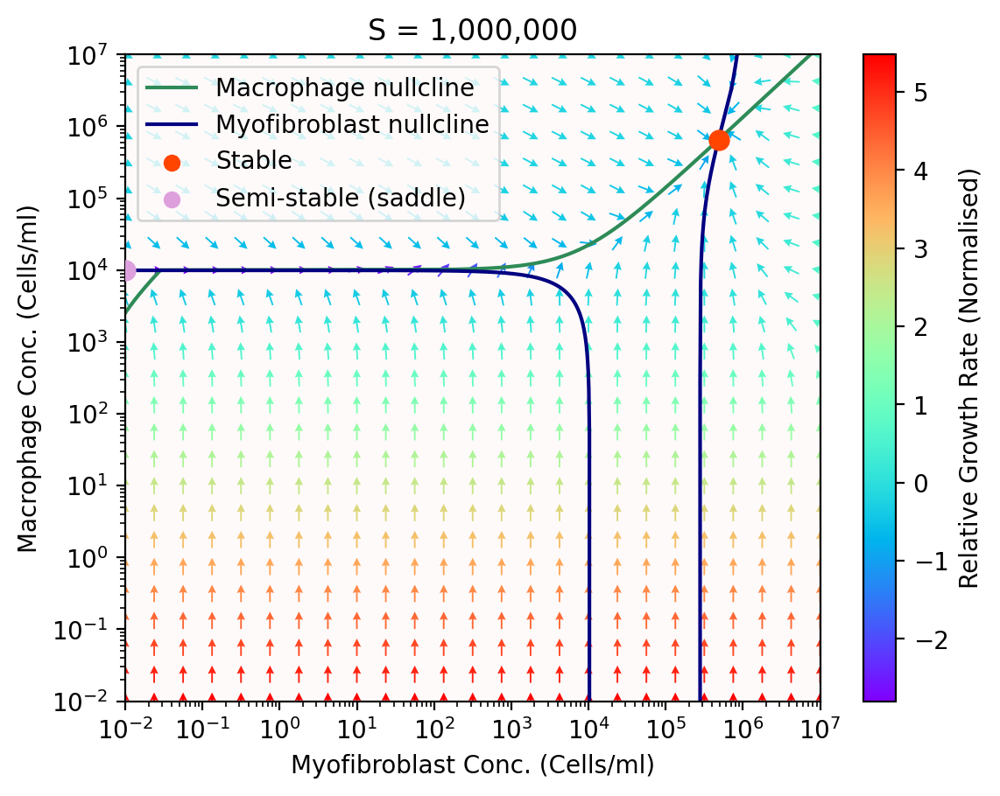

In [6]:
M_vals = np.logspace(-2,7,25) # Myofibroblast concentrations (x-axis)
F_vals = np.logspace(-2,7,25)  # Macrophage concentrations (y-axis)
# M_vals = np.linspace(0,20,40)
# F_vals = np.linspace(0,20,40)

fixed_S = 1000000  # Set a biologically relevant fixed value for Senescent cells. goes odd around the 992,000 mark
ptx,pty,labels,colors = fixed_points_S(sys_s1,fixed_S)
FM_space = np.logspace(-2, 7, 10**3)
Fnull1 = np.logspace(-2, 5.7, 10**3)
Fnull2 = np.logspace(5.85, 5.95, 10**3)
Fnull3 = np.logspace(6.05, 7, 10**3)

# Smooth bridge across pole gap
xsmooth1 = [10**5.7, 10**5.85]
ysmooth1 = [sys_s1.nullclines_F(pt)[1] for pt in xsmooth1]
# Macrophage nullcline (red)
M_vals_M, F_vals_M = sys_s1.nullclines_M_fixed_S(FM_space, S_fixed=fixed_S)
plt.plot(F_vals_M, M_vals_M, 'seagreen', label='Macrophage nullcline')
plt.plot(-1,-1, 'navy', label='Myofibroblast nullcline')
legend_points(unstable=False)
plt.title(f'S = {fixed_S:,}')
plt.legend()
plot_fp(ptx,pty,colors,labels)

# Myofibroblast nullcline (blue), skip S since it's not used
for Frange in [Fnull1, Fnull2, Fnull3]:
    Fvals = Frange
    Mvals = [sys_s1.nullclines_F(f)[1] for f in Fvals]
    plt.plot(Fvals, Mvals, 'navy', label='Myofibroblast nullcline')

# Bridge over vertical pole gap
plt.plot(xsmooth1, ysmooth1, 'navy')
plt.plot(-100,-100, 'black',alpha=0.8, label='Separatrix')


lims()
logax()

sys_s1.plot_2D_quiver_field_fixed_S(M_vals, F_vals, fixed_S,x_label="Myofibroblast Conc. (Cells/ml)",y_label="Macrophage Conc. (Cells/ml)")
#sep_pos_2,sep_neg_2 = sys_s1.separatrix(np.linspace(0,75,150),(pty[1],ptx[1],fixed_S),epsilon=100)


# plt.plot(sep_pos_2[1],sep_pos_2[0],'black',alpha=0.8)
# plt.plot(sep_neg_2[1],sep_neg_2[0],'black',alpha=0.8)

#plot_sep(fixed_pts_nons)

plt.show()

Fixed points calculated
[0.01, 483623.38] [10000.0, 652524.55]
0.01,10000.0,plum,Semi-stable (saddle)
483623.38,652524.55,orangered,Stable


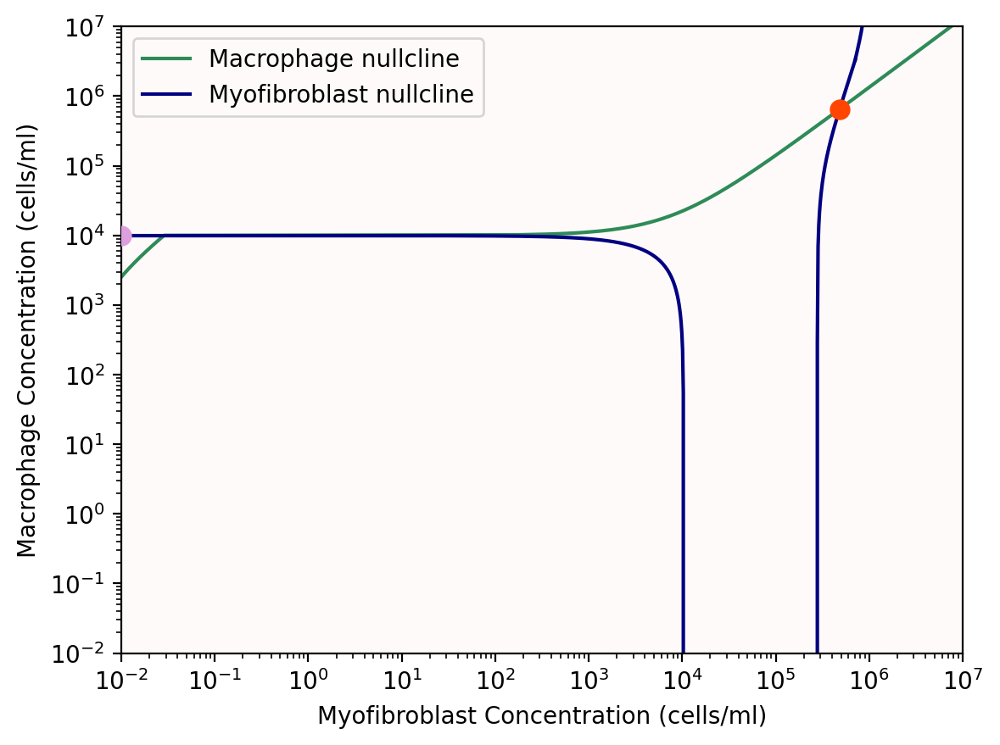

In [7]:
ptx,pty,labels,colors = fixed_points_S(sys_s1,fixed_S)

FM_space = np.logspace(-2, 7, 10**3)
Fnull1 = np.logspace(-2, 5.7, 10**3)
Fnull2 = np.logspace(5.85, 5.95, 10**3)
Fnull3 = np.logspace(6.05, 7, 10**3)

# Smooth bridge across pole gap
xsmooth1 = [10**5.7, 10**5.85]
ysmooth1 = [sys_s1.nullclines_F(pt)[1] for pt in xsmooth1]
# Macrophage nullcline (red)
M_vals_M, F_vals_M = sys_s1.nullclines_M_fixed_S(FM_space, S_fixed=fixed_S)
plt.plot(F_vals_M, M_vals_M, 'seagreen', label='Macrophage nullcline')
plt.plot(-1,-1, 'navy', label='Myofibroblast nullcline')
plt.legend()

# Myofibroblast nullcline (blue), skip S since it's not used
for Frange in [Fnull1, Fnull2, Fnull3]:
    Fvals = Frange
    Mvals = [sys_s1.nullclines_F(f)[1] for f in Fvals]
    plt.plot(Fvals, Mvals, 'navy', label='Myofibroblast nullcline')

# Bridge over vertical pole gap
plt.plot(xsmooth1, ysmooth1, 'navy')
logax()
axlabels()
lims()
plot_fp(ptx,pty,colors,labels)
plt.show()

Fixed points calculated
[0.01, 5313.2, 481393.78] [20.0, 4756.06, 639514.43]
0.01,20.0,orangered,Stable
5313.2,4756.06,plum,Semi-stable (saddle)
481393.78,639514.43,orangered,Stable
[0. 1. 0.] [-0.00126132 -0.00160248]


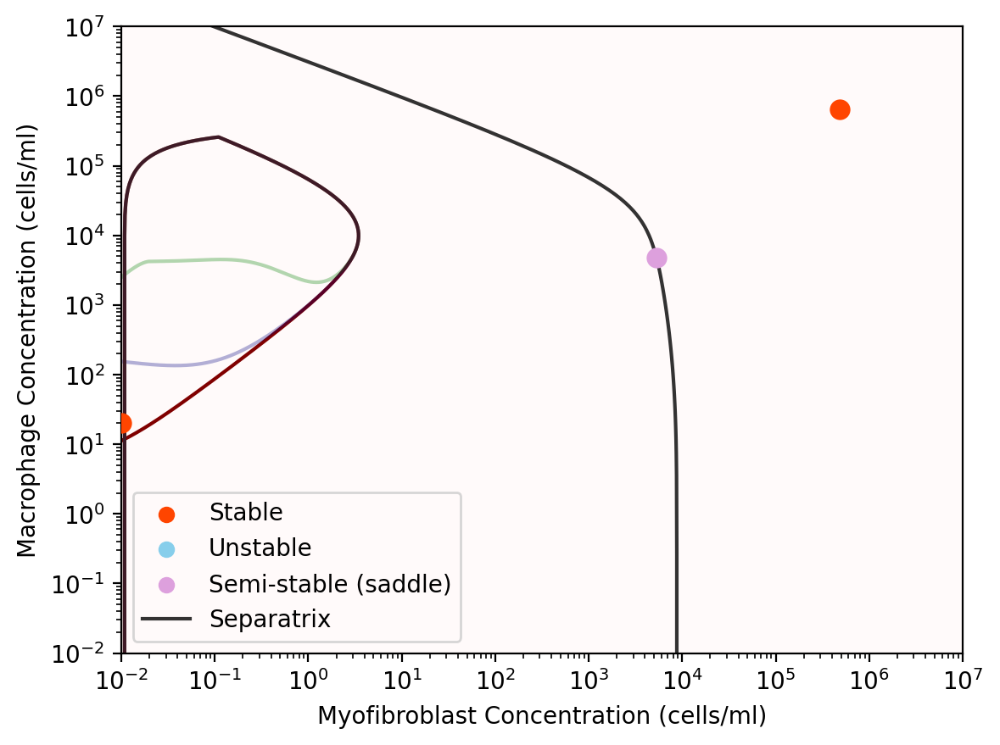

In [8]:
M_vals = np.logspace(-2,7,25) # Myofibroblast concentrations (x-axis)
F_vals = np.logspace(-2,7,25)  # Macrophage concentrations (y-axis)
# M_vals = np.linspace(0,20,40)
# F_vals = np.linspace(0,20,40)

fixed_S = 2000  # Set a biologically relevant fixed value for Senescent cells
ptx,pty,labels,colors = fixed_points_S(sys_s1,fixed_S)
legend_points()
plt.plot(-100,-100, 'black',alpha=0.8, label='Separatrix')

plt.legend()
plot_fp(ptx,pty,colors,labels)
lims()
logax()
#sys_s1.plot_2D_quiver_field_fixed_S(M_vals, F_vals, fixed_S,x_label="Myofibroblast Conc. (Cells/ml)",y_label="Macrophage Conc. (Cells/ml)")
sep_pos_2,sep_neg_2 = sys_s1.separatrix(np.linspace(0,75,150),(pty[1],ptx[1],2000),epsilon=50)

plt.plot(sep_pos_2[1],sep_pos_2[0],'black',alpha=0.8)
plt.plot(sep_neg_2[1],sep_neg_2[0],'black',alpha=0.8)

pulses_M = [(0,5,10**5)]
plot_trajectories(sys_s1,X0=[0,0.011,0],pulses_M=pulses_M)
pulses_S = [(0,50,10**5)]
plot_trajectories(sys_s1,X0=[0,0.011,0],pulses_M=pulses_M,pulses_S=pulses_S,color='green',alpha=0.3)

axlabels()
#plot_sep(fixed_pts_nons)

initial_state_fsm_2 = spm.state_fsm(10, 10, 10, 10, 10)  # Initial cell populations, M, F, P, C, S
    
initial_params_fsm_2 = spm.params_fsm(lam1=0.9, lam2=0.8, mu1=0.3, mu2=0.3, K=1e6, k1=1e9,k2=1e9,
                                beta1=470 * min2day,beta2=70 * min2day,beta3=240 * min2day,
                                alpha1=940 *min2day,alpha2=510 *min2day, gamma=2,
                                  n=0.00003,h=50, r=24, q=1e4)  # Parameters for the model
sys_s2 = fsm.fibrosis_senescence_model(initial_params_fsm_2,initial_state_fsm_2)
pulses_M = [(0,5,10**5)]
#plot_trajectories(sys_s2,X0=[0,0.011,0],pulses_M=pulses_M,color='gold')
pulses_S = [(0,50,10**5)]
plot_trajectories(sys_s2,X0=[0,0.011,0],pulses_M=pulses_M,pulses_S=pulses_S,color='navy',alpha=0.3)

axlabels()
#plot_sep(fixed_pts_nons)

plt.show()


Fixed points calculated
[0.01, 5321.01, 481391.53] [10.0, 4748.57, 639501.37]
[0. 1. 0.] [-0.00063179 -0.00160486]
Fixed points calculated
[0.01, 5251.38, 481411.82] [100.0, 4815.35, 639618.96]
[1. 0. 0.] [-0.00622979 -0.0015837 ]
Fixed points calculated
[0.01, 4619.12, 481614.58] [1000.0, 5422.79, 640794.61]
[1. 0. 0.] [-0.05532198 -0.00139215]


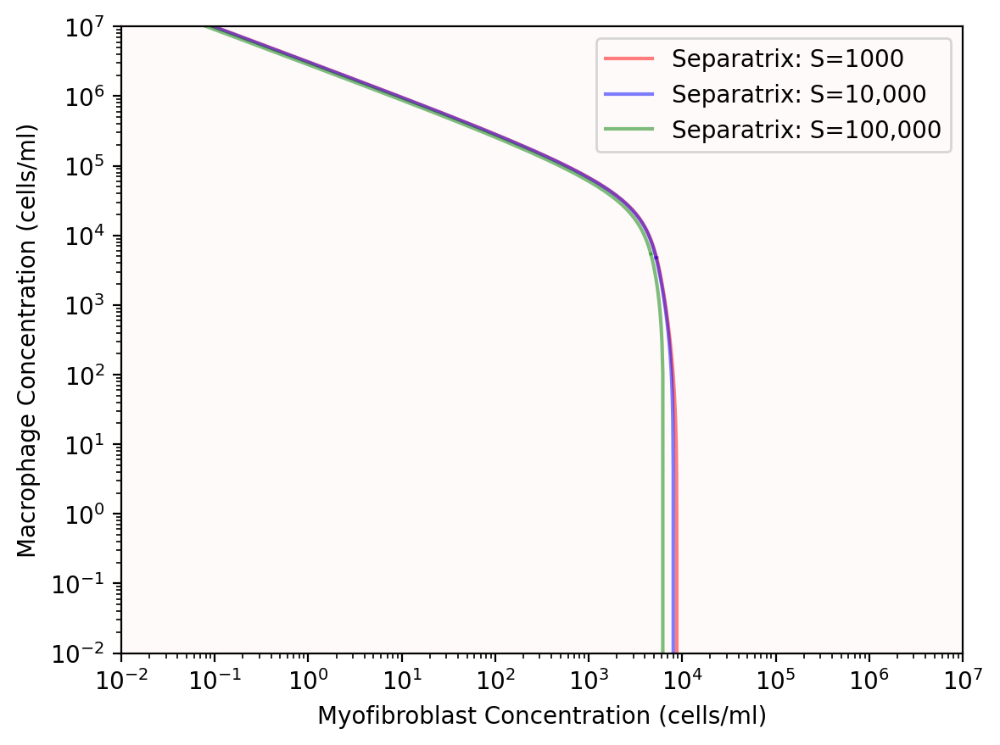

In [9]:
## Check multiple separatrices and see how varying S changes them

fixed_S = 1000  # Set a biologically relevant fixed value for Senescent cells
ptx,pty,labels,colors = fixed_points_S(sys_s1,fixed_S)
ep_pos_2,sep_neg_2 = sys_s1.separatrix(np.linspace(0,75,150),(pty[1],ptx[1],fixed_S),epsilon=50)


plt.plot(sep_pos_2[1],sep_pos_2[0],'red',alpha=0.5,label='Separatrix: S=1000')
plt.plot(sep_neg_2[1],sep_neg_2[0],'red',alpha=0.5)

fixed_S = 10000  # Set a biologically relevant fixed value for Senescent cells
ptx,pty,labels,colors = fixed_points_S(sys_s1,fixed_S)
#plot_sep(fixed_pts_nons)
sep_pos_3,sep_neg_3 = sys_s1.separatrix(np.linspace(0,75,150),(pty[1],ptx[1],fixed_S),epsilon=50)


plt.plot(sep_pos_3[1],sep_pos_3[0],'blue',alpha=0.5,label='Separatrix: S=10,000')
plt.plot(sep_neg_3[1],sep_neg_3[0],'blue',alpha=0.5)
fixed_S = 100000  # Set a biologically relevant fixed value for Senescent cells
ptx,pty,labels,colors = fixed_points_S(sys_s1,fixed_S)
#plot_sep(fixed_pts_nons)
sep_pos_4,sep_neg_4 = sys_s1.separatrix(np.linspace(0,75,150),(pty[1],ptx[1],fixed_S),epsilon=50)


plt.plot(sep_pos_4[1],sep_pos_4[0],'green',alpha=0.5,label='Separatrix: S=100,000')
plt.plot(sep_neg_4[1],sep_neg_4[0],'green',alpha=0.5)
plt.legend()
logax()
lims()
axlabels()
#plot_sep(fixed_pts_nons)
plt.show()

In [10]:
fig = sys_s1.nullclines_3D_plotly(-2, 7, 100, return_fig=True)



sys_s1.fixed_curve_3D_old(fig=fig, F_range=(1e-2, 10**5.82),num_points=500000, plot=True)
fig.update_layout(width=1800, height=1200)
legend_points_plotly(fig=fig,unstable=False)
plotly_fp_3D(sys_s1,fig=fig)
fig.write_html("my_figure.html")

fig.show()

Fixed Point 0: F: 0.01, M: 15.51, S: 1551.3 (saddle)
Fixed Point 1: F: 5328.81, M: 4741.09, S: 4.4 (saddle)
Fixed Point 2: F: 481389.27, M: 639488.3, S: 0.03 (stable)


In [11]:
# Step 1: Run Monte-Carlo sampling
#pts, labels = sys_s1.monte_carlo_classify(n_samples=220000)

# Step 2: Extract surface
#sys_s1.extract_marching_cubes_surface(pts, labels, resolution=150)


In [12]:
data = np.load(r"C:\Users\niall\Documents\MPhys\Systems-Medicine-for-Chronic-Kidney-Disease\monte_carlo_classification_new.npz")
pts = data["points"]
labels = data["labels"]


verts, faces = sys_s1.extract_marching_cubes_surface(pts, labels,sigma=3, resolution=450)


📊 Interpolating data to 3D grid...


KeyboardInterrupt: 

In [ ]:
#fig = sys_s1.nullclines_3D_plotly(start=0, stop=6, steps=100, return_fig=True)
fig = sys_s1.fixed_curve_3D_old(F_range=(1e-2, 10**5.82),num_points=750000, plot=True)
# Load .npz

# Step 2: Unpack for Plotly
x, y, z = verts.T
i, j, k = faces.T

# Step 3: Create a Plotly Mesh3d trace
separatrix_trace = go.Mesh3d(
    x=x, y=y, z=z,
    i=i, j=j, k=k,
    opacity=0.4,
    color='gray',
    name='Separatrix Surface',
    showlegend=True
)

# Step 4: Add to existing figure
fig.add_trace(separatrix_trace)
plotly_fp_3D(sys_s1,fig=fig)
fig.update_layout(width=1800, height=1200)
legend_points_plotly(fig=fig,unstable=False)
fig.write_html("my_figure.html")

fig.show()


In [ ]:
fig3d = sys_s1.plot_log_quiver_3D(
    M_range=(0.01, 1e6),
    F_range=(0.01, 1e6),
    S_range=(0.01, 1e6),
    n=7,
    sizeref=0.3,
    opacity=0.5,
    uniform_color='blue'
)
#fig = sys_s1.fixed_curve_3D_old(fig=fig3d,F_range=(1e-2, 10**5.82),num_points=750000, plot=True)
pulses_M = [(0,1,10**5)]
pulses_S = [(0,1,10**5)]
#plot_3D_trajectories(sys_s1,X0=[1,1,1],pulses_M=pulses_M,pulses_S=pulses_S,color='navy',alpha=1,log=True,fig=fig3d)
plotly_fp_3D(sys_s1,fig=fig3d)
fig3d.add_trace(separatrix_trace)
fig.update_layout(width=1800, height=1200)
legend_points_plotly(fig=fig3d,unstable=False)
fig3d.write_html("my_figure.html")
fig3d.show()

In [ ]:
initial_params_fsm2 = spm.params_fsm(lam1=0.9, lam2=0.8, mu1=0.3, mu2=0.3, K=1e6, k1=1e9,k2=1e9,
                                beta1=470 * min2day,beta2=70 * min2day,beta3=240 * min2day,
                                alpha1=940 *min2day,alpha2=510 *min2day, gamma=2,
                                  n=0.003,h=50, r=0.24, q=1e4)  # Parameters for the model
sys_s2 = fsm.fibrosis_senescence_model(initial_params_fsm2,initial_state_fsm)

Final Position (639488.342440199, 481389.28183941456, 3.2588745325763)
Final Position (639488.3507198431, 481389.28804774786, 3.2588744712398876)
Fixed Point 0: F: 0.01, M: 282.17, S: 28216.67 (saddle)
Fixed Point 1: F: 5325.24, M: 4744.51, S: 459.27 (saddle)
Fixed Point 2: F: 481389.28, M: 639488.34, S: 3.26 (stable)


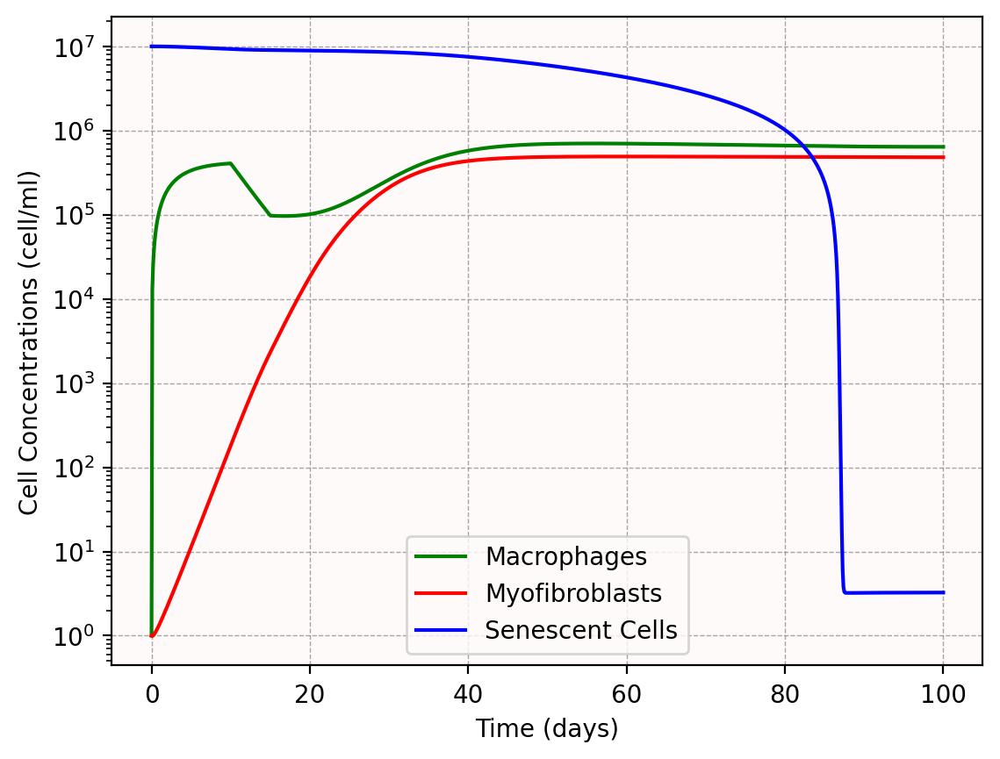

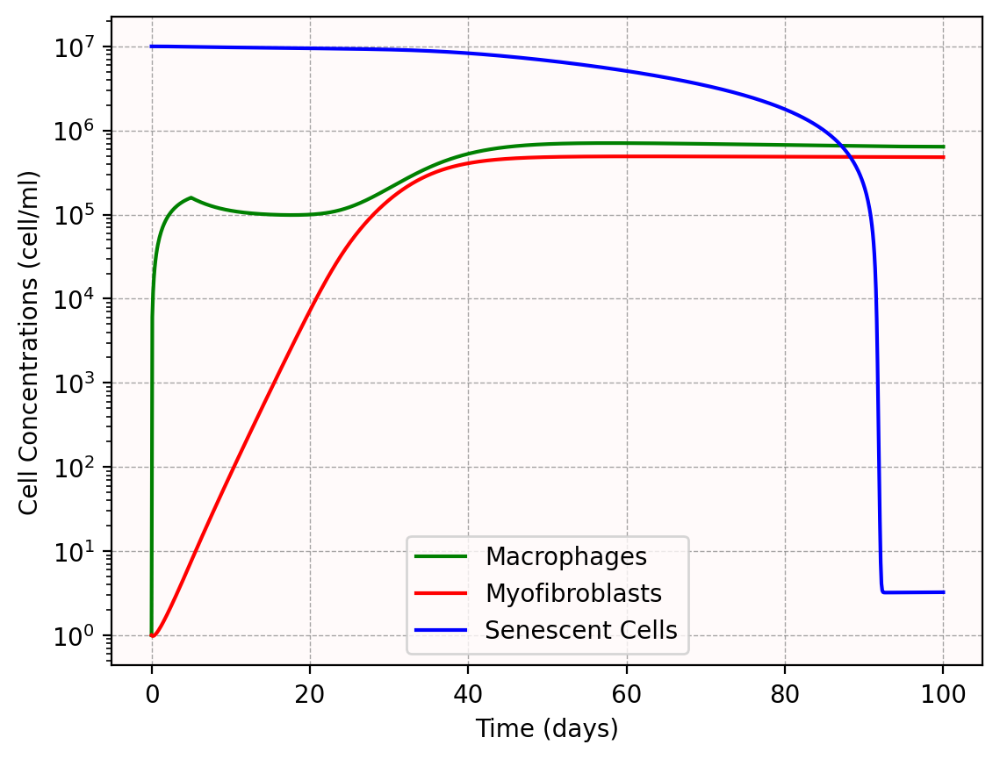

In [ ]:
X = [1,1,1e7]

#fig = sys_s1.nullclines_3D_plotly(start=0, stop=7, steps=80, return_fig=True)
pulses_M = [(0,10,10**5),(10,15,-10**4.4)]#,(10,15,10**4.2),(20,25,10**4.2)] # in first one, latter term is for removal
pulses_M2 = [(0,5,10**4.4),(10,15,10**4.4),(20,25,10**4.4)]
pulses_M3 = [(0,5,10**4.5)]
pulses_S=[(0,0,0)]
#pulses_S =[(0,10,10**5.2)] #This used for most pulses
#pulses_S =[(0,10,10**5.2),(0,20,-10**4.9)] 
fig=plot_3D_trajectories(sys_s2,X0=X,pulses_M=pulses_M,pulses_S=pulses_S,color='navy',alpha=0.8,log=True,label='Large Injury',t=np.linspace(0,10000,100000))
#plot_3D_trajectories(sys_s2,X0=X,pulses_M=pulses_M2,pulses_S=pulses_S,color='crimson',alpha=0.8,log=True,label='Multiple Injuries',fig=fig,t=np.linspace(0,10000,100000))
plot_3D_trajectories(sys_s2,X0=X,pulses_M=pulses_M3,pulses_S=pulses_S,color='seagreen',alpha=0.8,log=True,label='Small Injury',fig=fig,t=np.linspace(0,10000,100000))

# Load .npz
plotly_fp_3D(sys_s2,fig=fig)

# Step 1: Extract the marching cubes vertices and faces

# Step 2: Unpack for Plotly
x, y, z = verts.T
i, j, k = faces.T

# Step 3: Create a Plotly Mesh3d trace
separatrix_trace = go.Mesh3d(
    x=x, y=y, z=z,
    i=i, j=j, k=k,
    opacity=0.4,
    color='gray',
    name='Separatrix',
    showlegend=True
)

# Step 4: Add to existing figure
fig.add_trace(separatrix_trace)
#sys_s2.fixed_curve_3D_old(fig=fig, F_range=(1e-2, 10**5.82),num_points=750000, plot=True)
legend_points_plotly(fig=fig,unstable=False)
fig.show()
# Step 5: Show
fig.write_html("my_figure.html")
plot_timeseries(sys_s2,X0=X,pulses_M=pulses_M,pulses_S=pulses_S)
plt.grid(True, which='major', linestyle='--', linewidth=0.5, color='gray', alpha=0.7)
plt.show()
# plot_timeseries(sys_s2,X0=X,pulses_M=pulses_M2,pulses_S=pulses_S)
# plt.grid(True, which='major', linestyle='--', linewidth=0.5, color='gray', alpha=0.7)
# plt.show()
plot_timeseries(sys_s2,X0=X,pulses_M=pulses_M3,pulses_S=pulses_S)
plt.grid(True, which='major', linestyle='--', linewidth=0.5, color='gray', alpha=0.7)
plt.show()

In [ ]:
fig3d = sys_s2.plot_log_quiver_3D(
    M_range=(0.01, 1e6),
    F_range=(0.01, 1e6),
    S_range=(0.01, 1e6),
    n=7,
    sizeref=0.3,
    opacity=0.5,
    uniform_color='blue'
)
#fig = sys_s1.fixed_curve_3D_old(fig=fig3d,F_range=(1e-2, 10**5.82),num_points=750000, plot=True)
pulses_M = [(0,1,10**5)]
pulses_S = [(0,1,10**5)]
#plot_3D_trajectories(sys_s1,X0=[1,1,1],pulses_M=pulses_M,pulses_S=pulses_S,color='navy',alpha=1,log=True,fig=fig3d)
plotly_fp_3D(sys_s2,fig=fig3d)
fig3d.add_trace(separatrix_trace)
fig.update_layout(width=1800, height=1200)
legend_points_plotly(fig=fig3d,unstable=False)
fig3d.write_html("my_figure.html")
fig3d.show()